## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

print('Modules Imported !!')

Modules Imported !!


In [2]:
def cal_undistort(img, objpoints, imgpoints):
    # Convert the image to grey scale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    shape = gray.shape[::-1]
    # Use cv2.calibrateCamera and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, shape,None,None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

Total of calibration images:  20


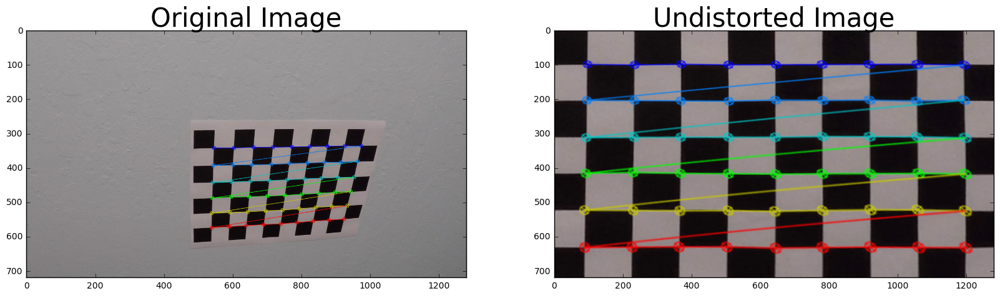

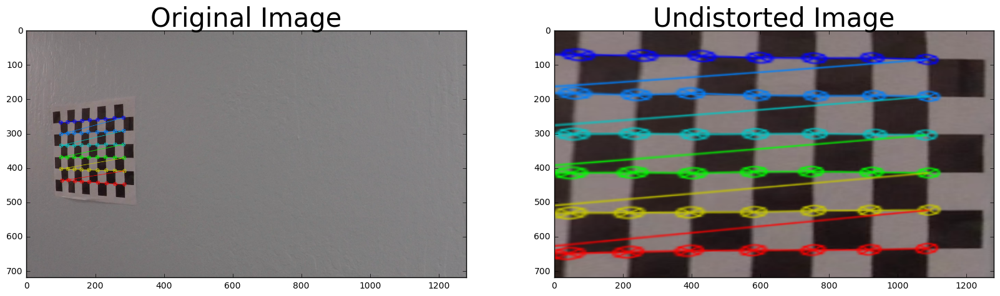

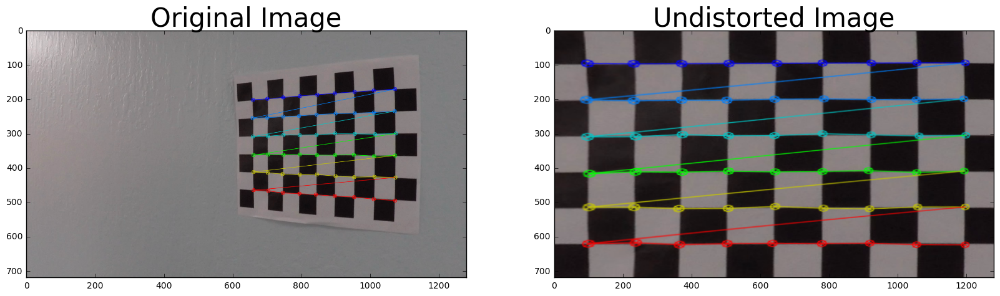

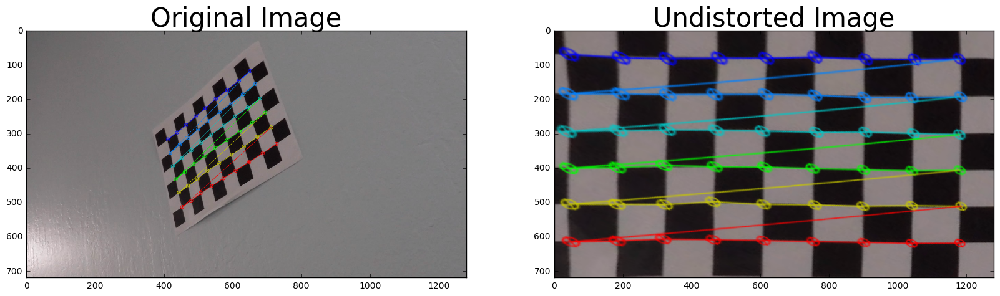

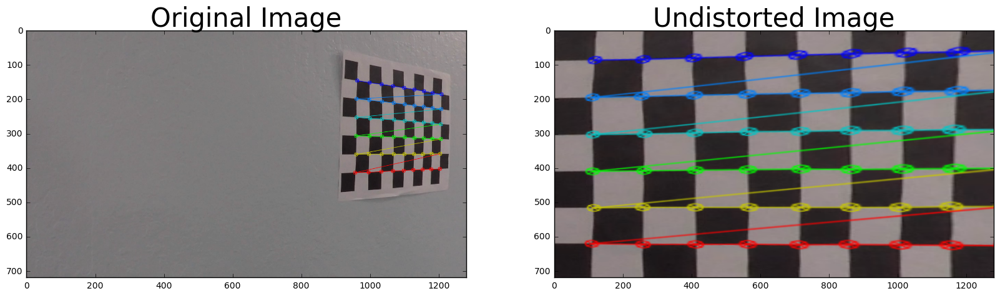

...

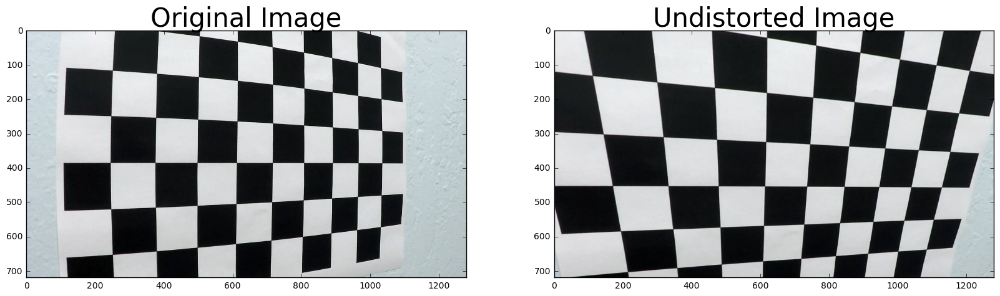

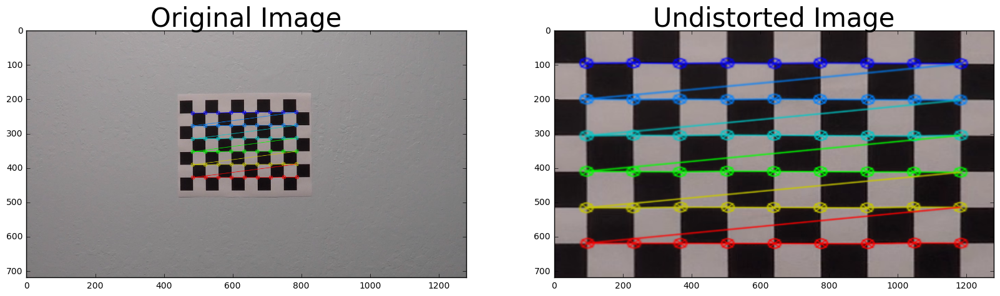

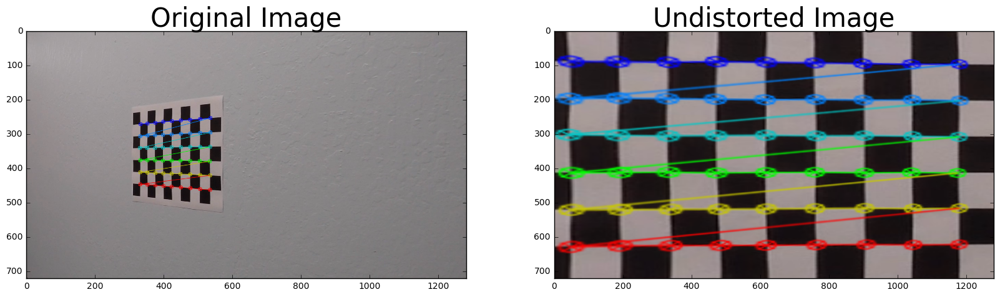

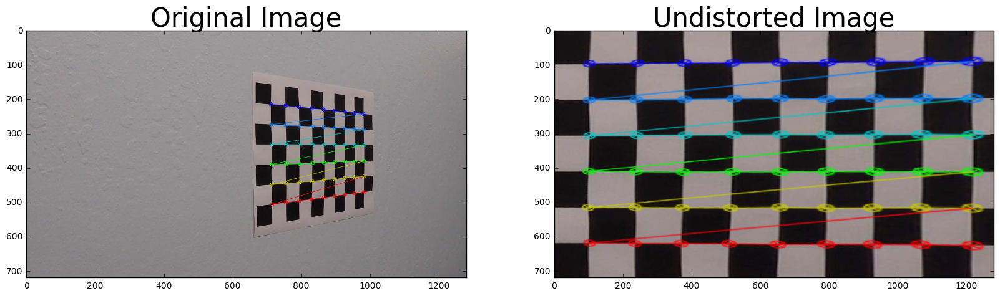

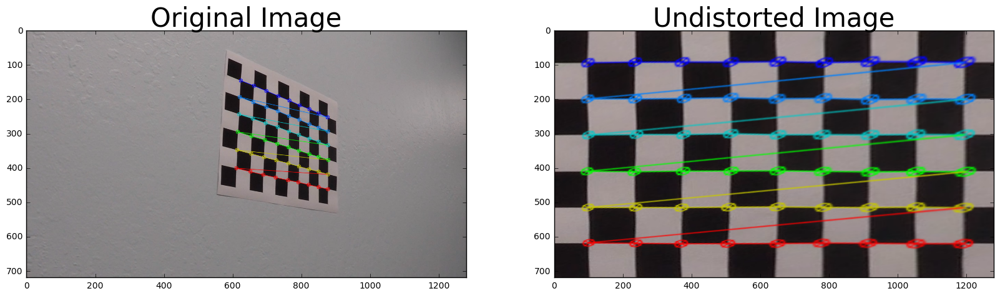

In [3]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

nx = 9
ny = 6

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

print('Total of calibration images: ', len(images))

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        offset = 100 # offset for dst points
        img_size = (gray.shape[1], gray.shape[0])
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        
    if objpoints and imgpoints:
        undistwarped_img = cal_undistort(img, objpoints, imgpoints)
        warped = cv2.warpPerspective(undistwarped_img, M, img_size)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(warped)
        ax2.set_title('Undistorted Image', fontsize=30)

In [4]:
def warp(img, src_points, dst_points):
    
    img_size = (img.shape[1], img.shape[0])
    
    # Four source coordinates based on the points defined
    src = np.float32(src_points)
    
    # Four destination desired coordinates
    dst = np.float32(dst_points)
    
    # Compute the perspective transform, M to warp the image 
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Compute warped image - uses linear interpolation
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Create warped image - using linear interpolation
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped

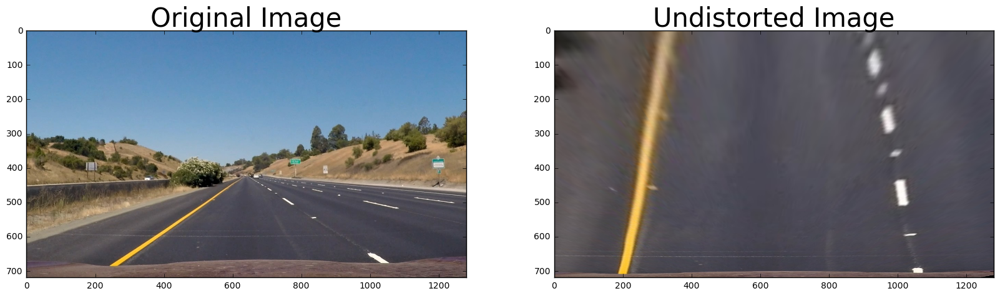

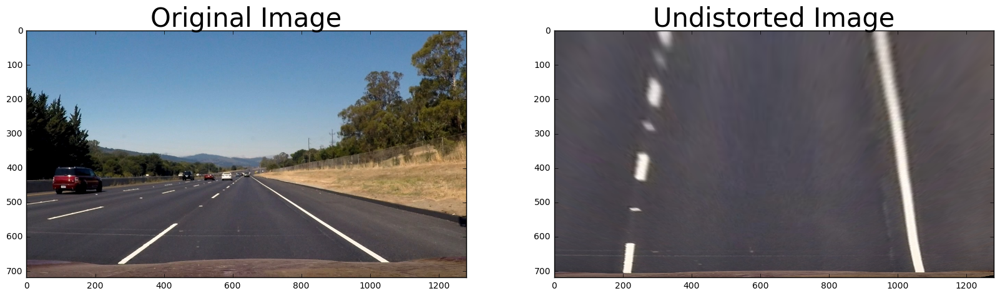

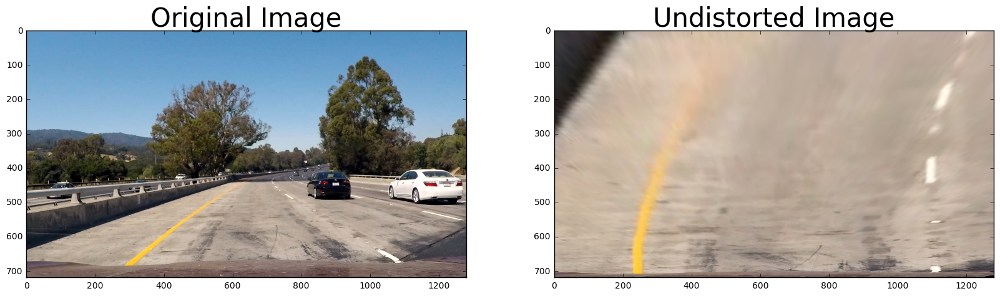

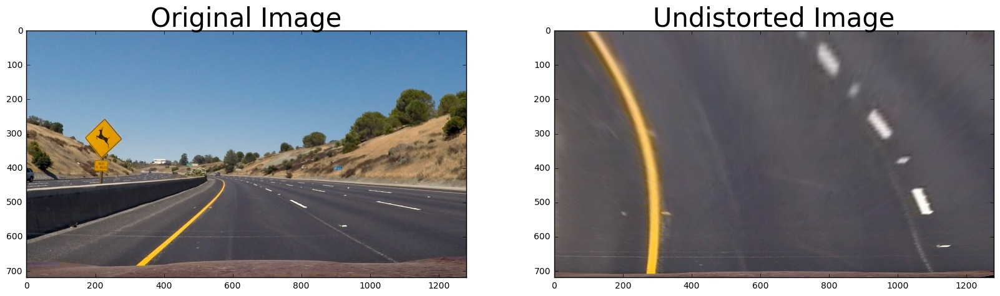

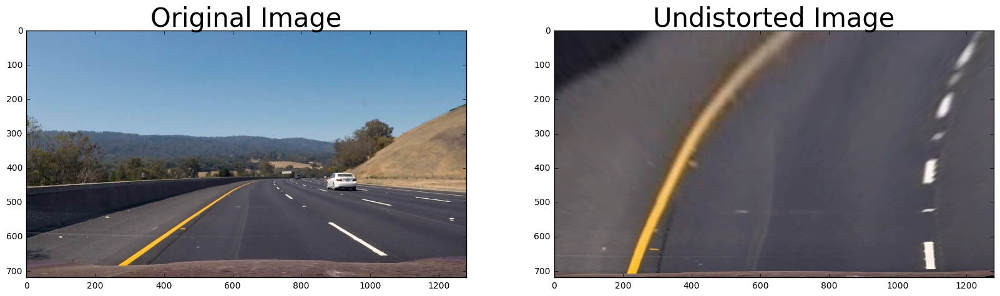

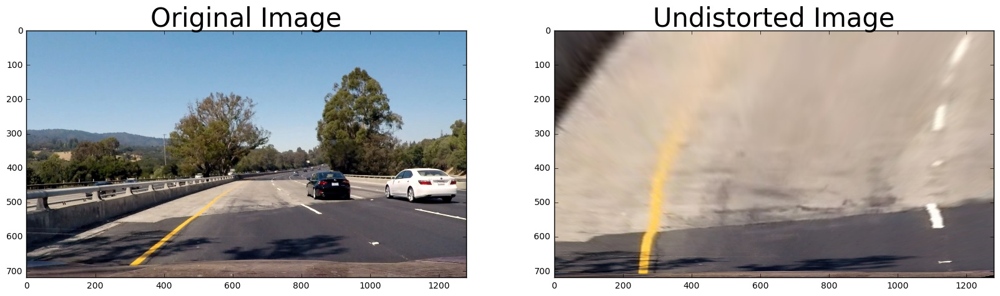

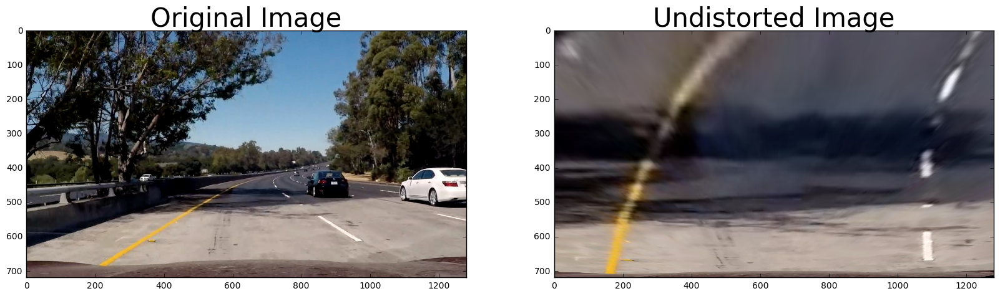

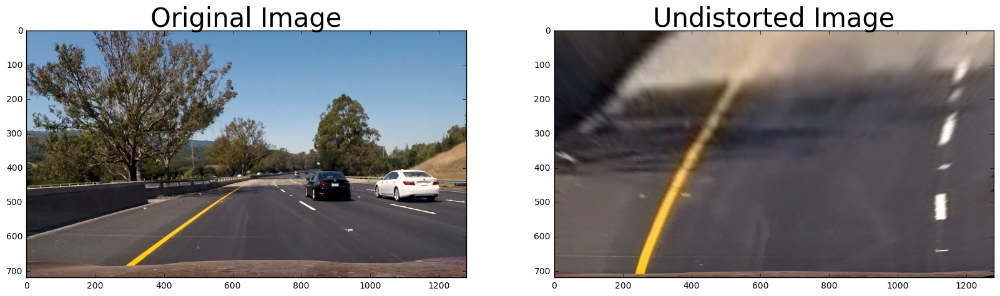

In [5]:
# Test images -- 
test_images = ['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 
               'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']
dist_images = []

for image in test_images:
    img = cv2.imread('./test_images/' + image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    im_shape = img.shape
    height = im_shape[0]
    width = im_shape[1]
    
    # Got those points with a help from a student in the forums, I would like to calculate them, dont fully 
    # understand this part
    src_points = [(215, 715), (1120, 715), (606, 431), (676, 431)]
    dst_points = [(200, 720), (1080, 720), (200, -500), (1080, -500)]

    warped_image = warp(img, src_points, dst_points)
    dist_images.append(warped_image)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(warped_image)
    ax2.set_title('Undistorted Image', fontsize=30)

In [6]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return grad_binary

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag) / 255
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    mag_binary = np.zeros_like(gradmag)
    mag_binary[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    return mag_binary

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return dir_binary

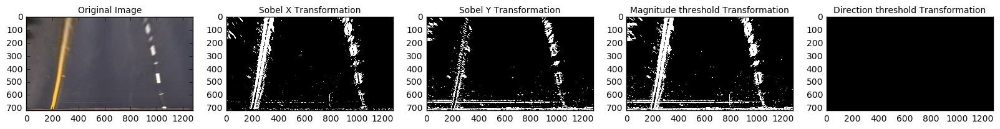

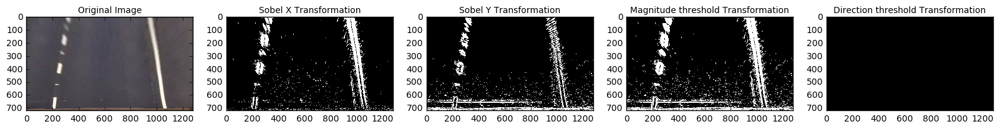

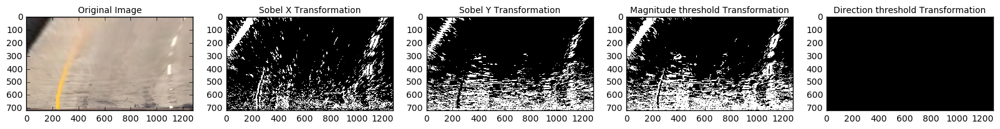

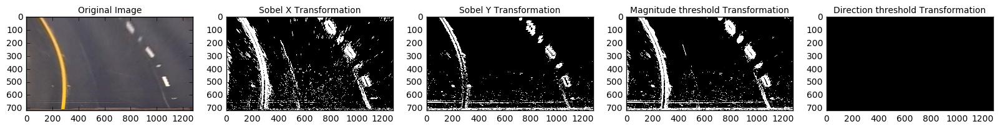

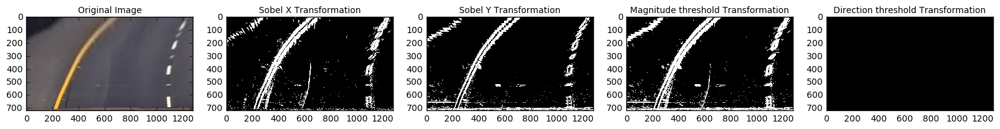

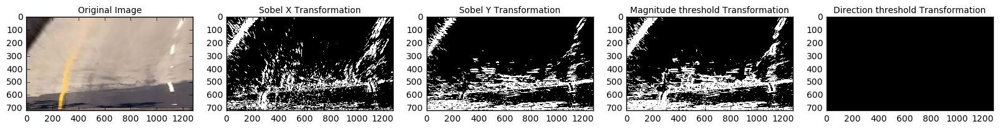

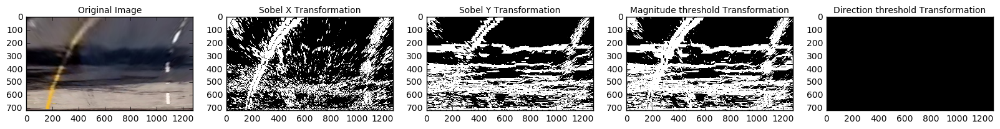

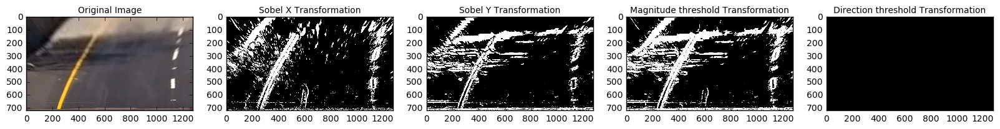

In [7]:
# Choose a Sobel kernel size
ksize = 9 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
for image in dist_images:
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(5, 200))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(5, 200))
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(5, 200))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(20, np.pi/2))
    f, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=10)
    
    ax2.imshow(gradx, cmap='gray')
    ax2.set_title('Sobel X Transformation', fontsize=10)
    
    ax3.imshow(grady, cmap='gray')
    ax3.set_title('Sobel Y Transformation', fontsize=10)
    
    ax4.imshow(mag_binary, cmap='gray')
    ax4.set_title('Magnitude threshold Transformation', fontsize=10)
    
    ax5.imshow(dir_binary, cmap='gray')
    ax5.set_title('Direction threshold Transformation', fontsize=10)

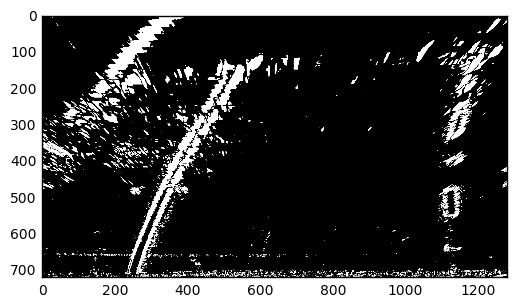

In [8]:
combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
plt.imshow(combined, cmap='gray')

In [9]:
def hls_select(img, thresh=(0, 255)):
    hls_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls_image[:,:,0]
    L = hls_image[:,:,1]
    S = hls_image[:,:,2]
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1 
    return binary_output

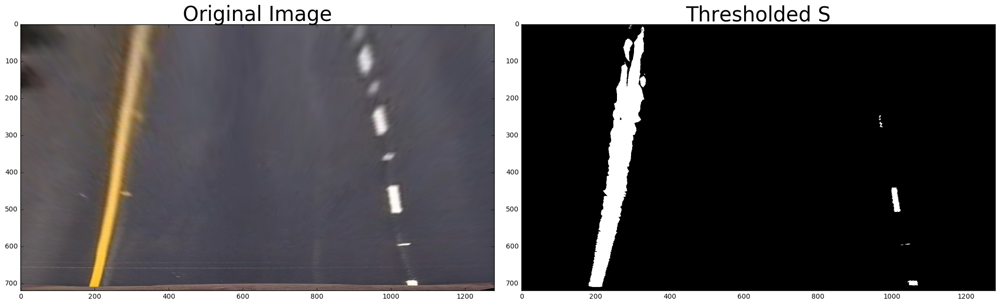

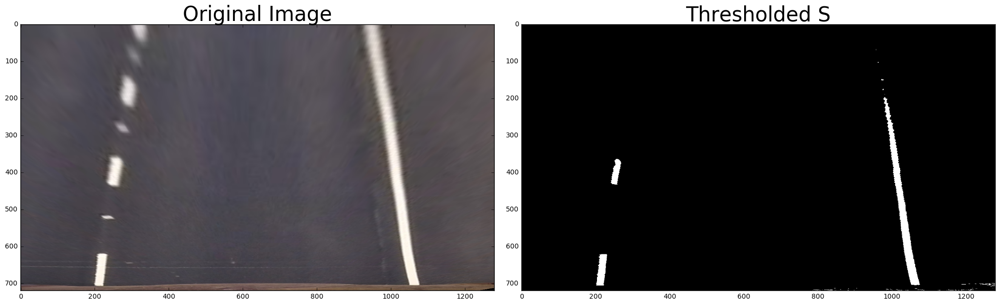

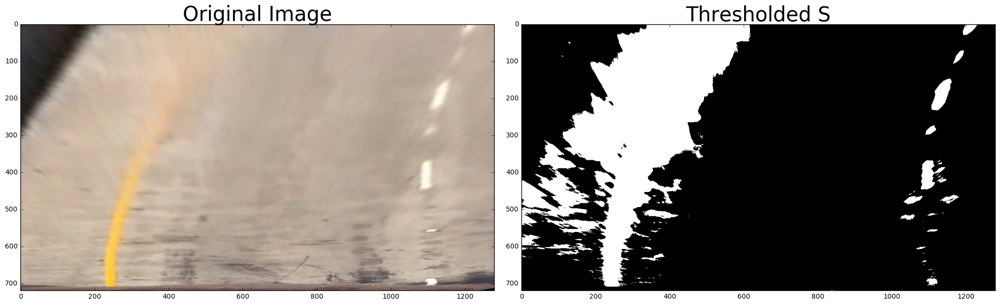

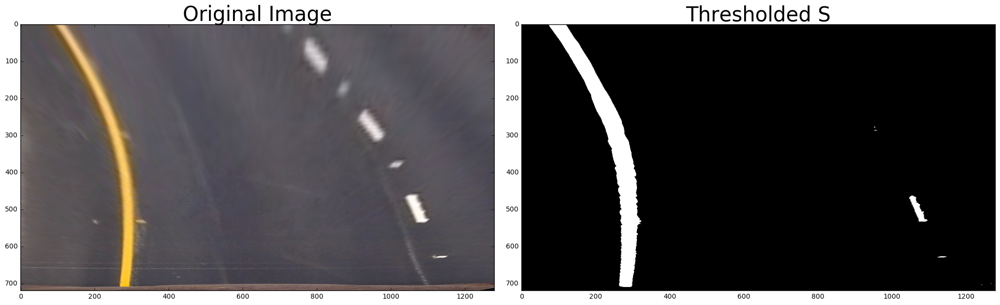

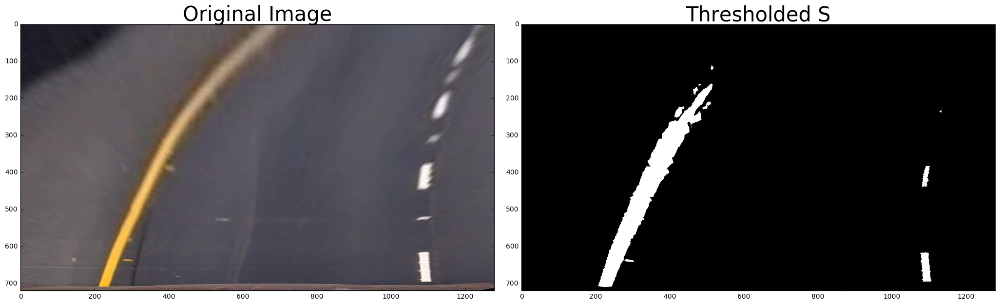

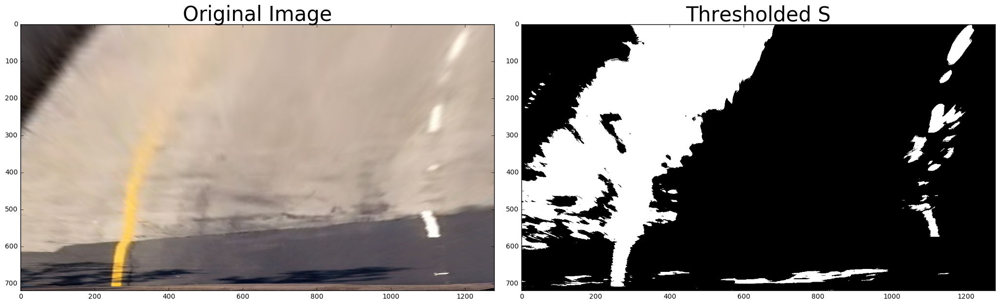

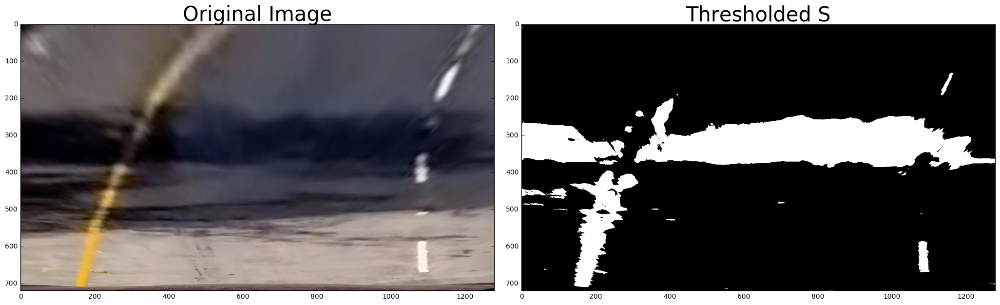

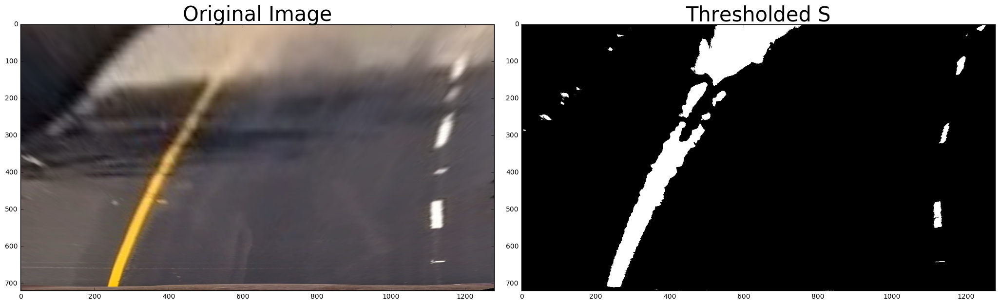

In [10]:
for image in dist_images:
    hls_binary = hls_select(image, thresh=(70, 255))
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(hls_binary, cmap='gray')
    ax2.set_title('Thresholded S', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [11]:
def image_pipeline(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    return color_binary

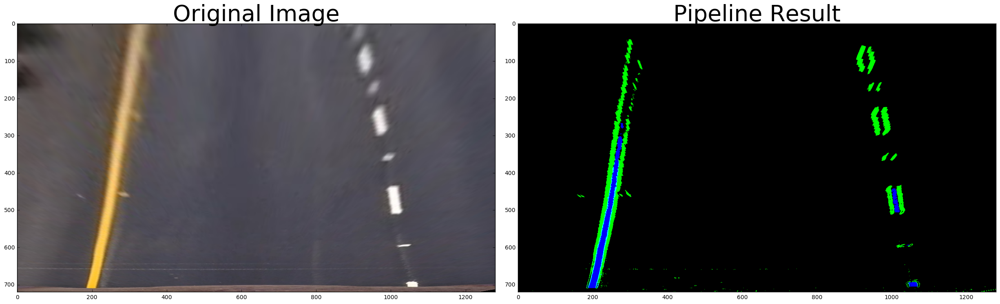

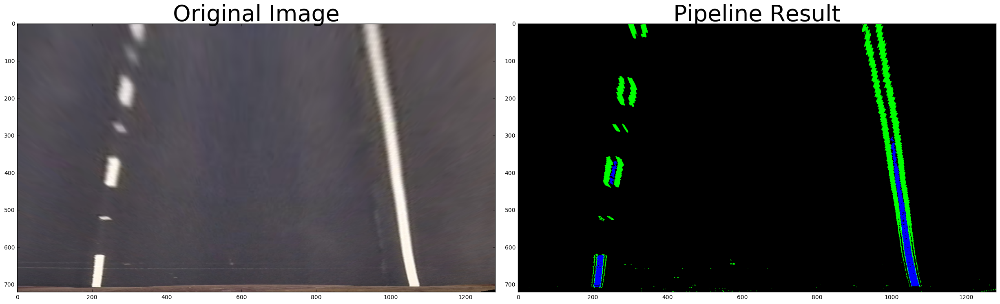

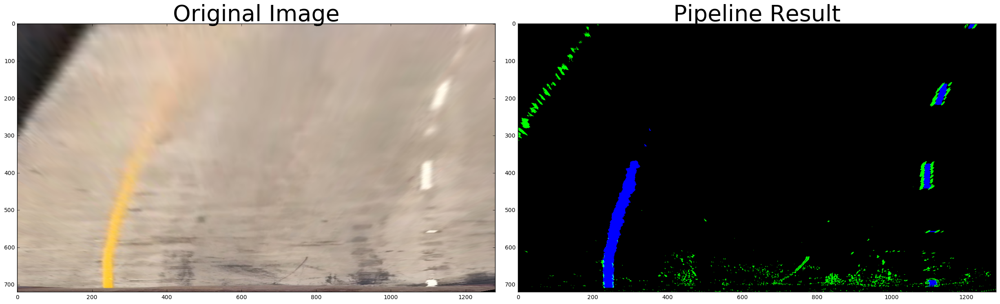

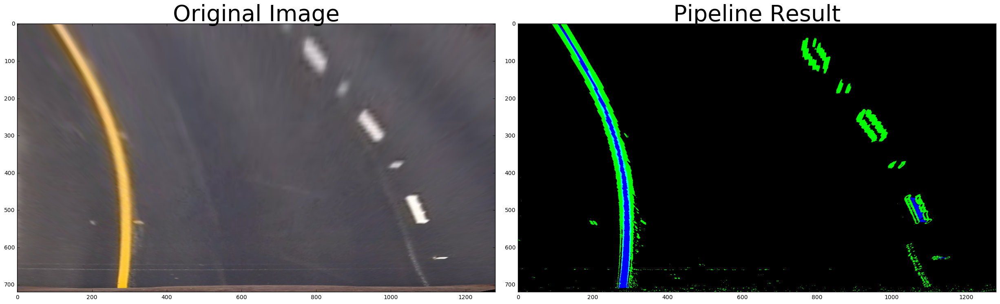

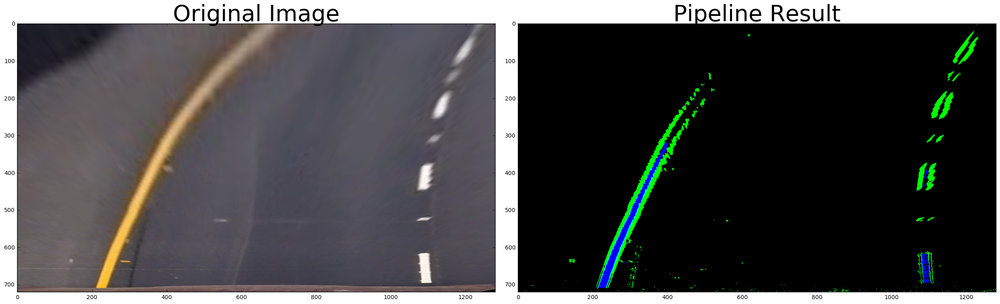

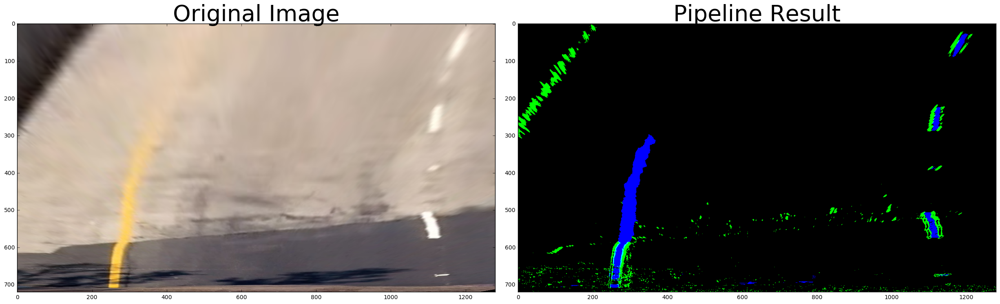

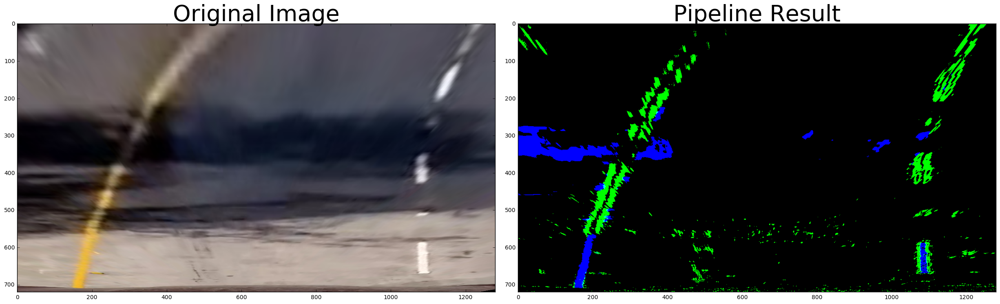

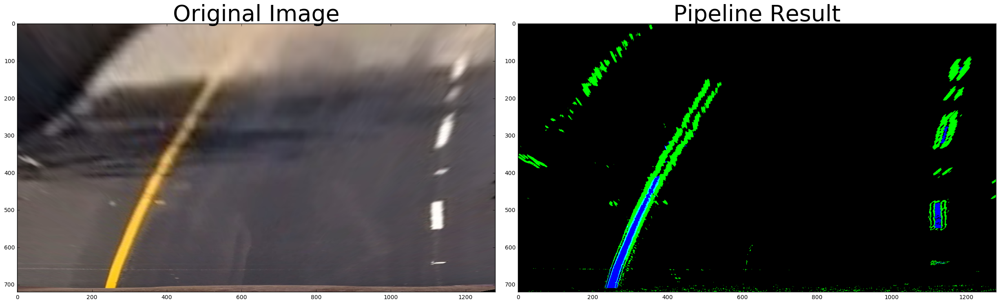

In [12]:
for image in dist_images:
    result = image_pipeline(image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)
    ax2.imshow(result)
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

/home/Jake/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


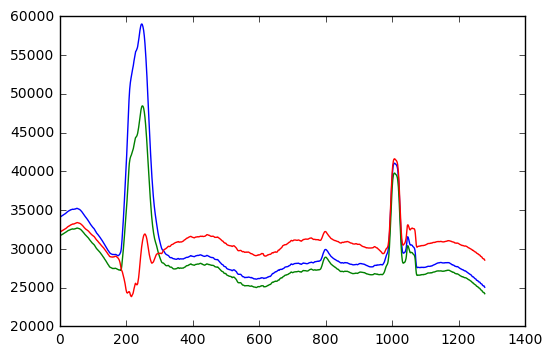

In [13]:
# Lets plot some histograms
image = dist_images[0]
histogram = np.sum(image[image.shape[0]/2:,:], axis=0)
plt.plot(histogram)

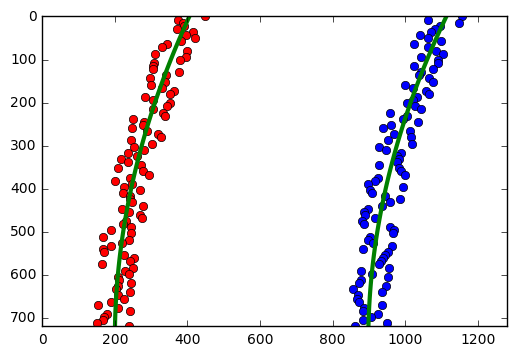

In [14]:
# Playing with Udacity's line generating code

# Generate some fake data to represent lane-line pixels
yvals = np.linspace(0, 100, num=101)*7.2  # to cover same y-range as image
leftx = np.array([200 + (elem**2)*4e-4 + np.random.randint(-50, high=51) 
                              for idx, elem in enumerate(yvals)])
leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
rightx = np.array([900 + (elem**2)*4e-4 + np.random.randint(-50, high=51) 
                                for idx, elem in enumerate(yvals)])
rightx = rightx[::-1]  # Reverse to match top-to-bottom in y

# Fit a second order polynomial to each fake lane line
left_fit = np.polyfit(yvals, leftx, 2)
left_fitx = left_fit[0]*yvals**2 + left_fit[1]*yvals + left_fit[2]
right_fit = np.polyfit(yvals, rightx, 2)
right_fitx = right_fit[0]*yvals**2 + right_fit[1]*yvals + right_fit[2]

# Plot up the fake data
plt.plot(leftx, yvals, 'o', color='red')
plt.plot(rightx, yvals, 'o', color='blue')
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, yvals, color='green', linewidth=3)
plt.plot(right_fitx, yvals, color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images

In [15]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(yvals)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) \
                             /np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) \
                                /np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
# Example values: 1163.9    1213.7

1377.7049439 1339.75353749


In [16]:
#Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

### How did I approach the project?
Initially I had a set of steps in mind that I would like to go through to be able to reach the final pipeline. After starting initially in the notebook, due to the help of Mehdi's blog post: https://medium.com/@MSqalli/advanced-lane-detection-6a769de0d581#.n5ch038d9

I noticed that he split his pipeline based on functional pieces, and that really facilitated my understanding of how to approach the project. I initially started with a cambera_calibration and image_gen classes, then I currently have the following classes:

* Undistort: Calibrates the camera and stores the needed values and takes any image to undistort. 

For this step here are some examples of undistorted images from the test images provided by udacity:


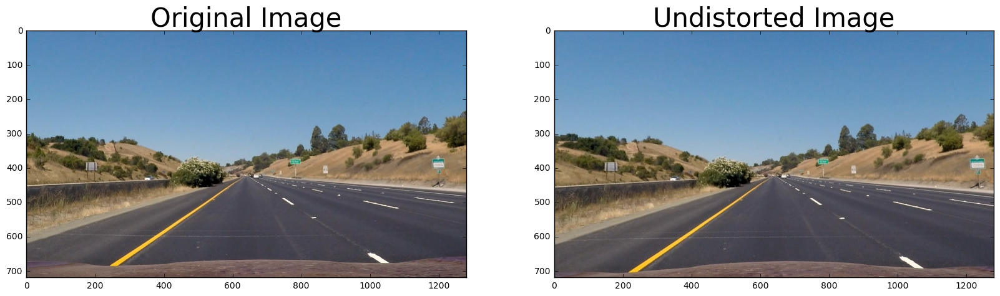

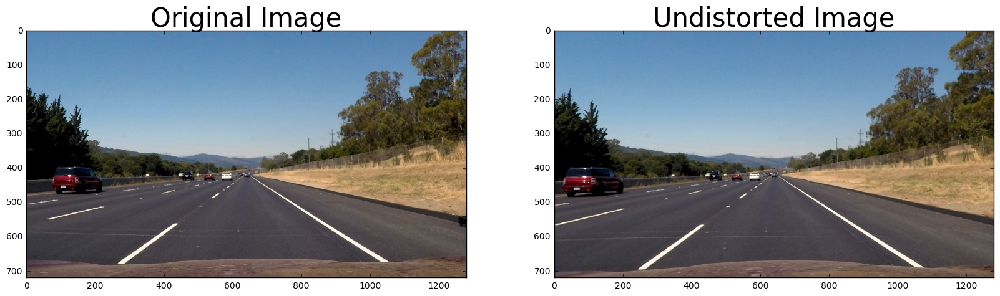

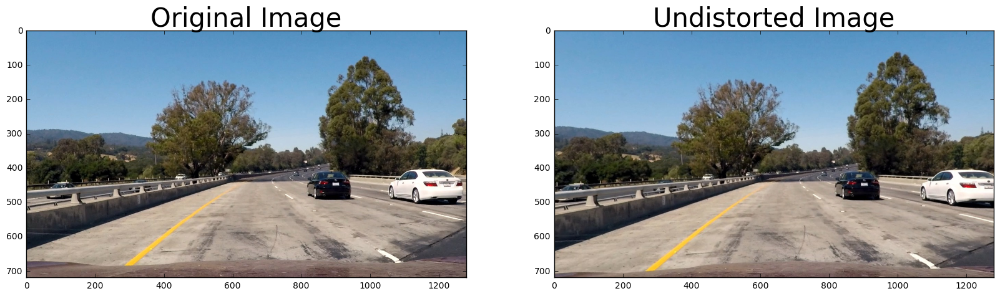

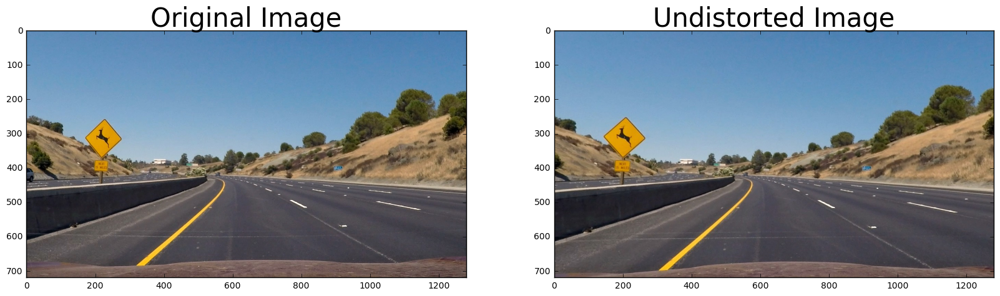

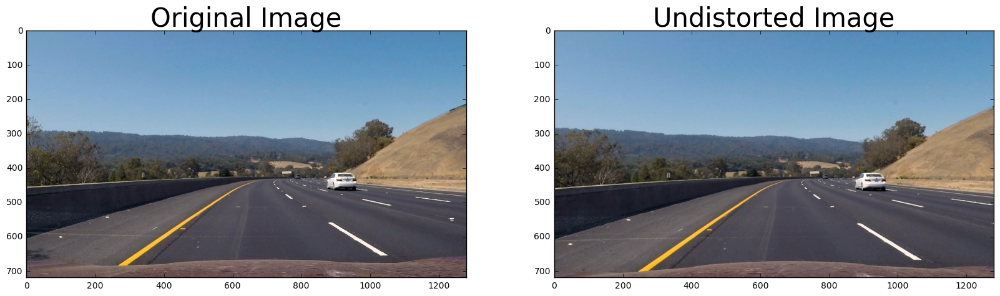

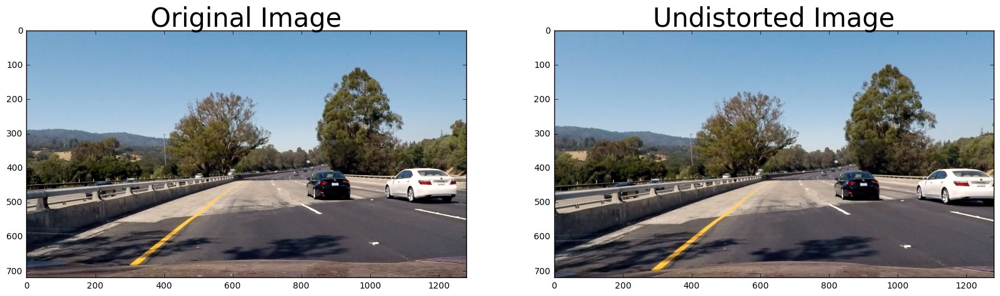

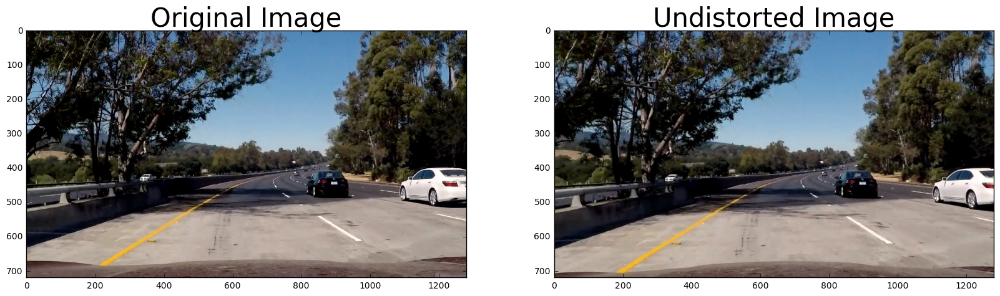

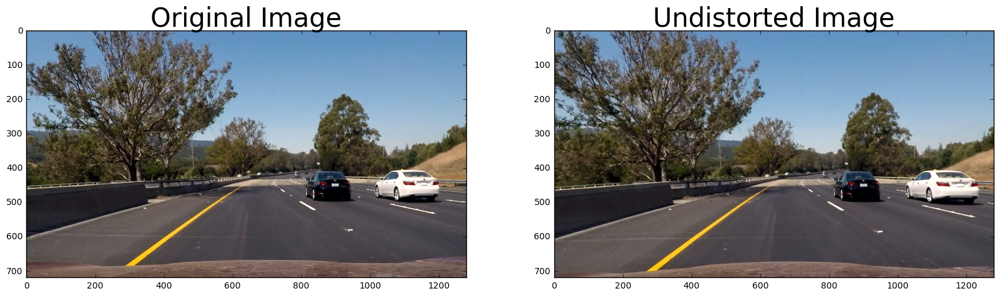

In [17]:
# un distorted images:
output_img_prefix = './output_images/undistorted_{}'
original_img_prefix = './test_images/{}'
test_images = ['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']
for image in test_images:
    original_img = mpimg.imread(original_img_prefix.format(image))
    output_img = mpimg.imread(output_img_prefix.format(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(original_img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(output_img)
    ax2.set_title('Undistorted Image', fontsize=30)

* Threshold: During the lecture we experimented with a variety of thresholds such as magnitude threshold, directional threshold, sobel x and y, and color thresholding.

I have ended up experimenting with all however ended up using the magnitude, direction and color thresholds. 
Here are examples of how the test images looked like being transformed

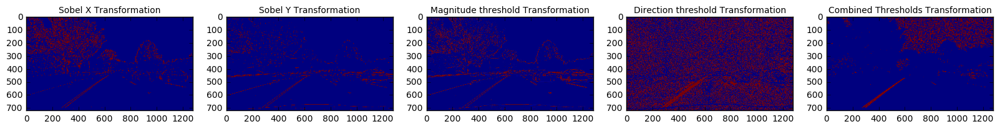

In [18]:
gradx = mpimg.imread('./output_images/abs_sobel_x.png')
grady = mpimg.imread('./output_images/abs_sobel_y.png')
mag = mpimg.imread('./output_images/mag_threshold.jpg')
direc = mpimg.imread('./output_images/directional_threshold.jpg')
color = mpimg.imread('./output_images/color_threshold.jpg')
combined = mpimg.imread('./output_images/combined.png')

f, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(20,10))
ax1.imshow(gradx, cmap='gray')
ax1.set_title('Sobel X Transformation', fontsize=10)
    
ax2.imshow(grady, cmap='gray')
ax2.set_title('Sobel Y Transformation', fontsize=10)
    
ax3.imshow(mag, cmap='gray')
ax3.set_title('Magnitude threshold Transformation', fontsize=10)
    
ax4.imshow(direc, cmap='gray')
ax4.set_title('Direction threshold Transformation', fontsize=10)

ax5.imshow(combined, cmap="gray")
ax5.set_title('Combined Thresholds Transformation', fontsize = 10)

During toying with thresholds I have experimented with a variety of sobel kernel sizes ranging from 3 to 15 and found that higher values helped my transformation to perform better.

here is how currently the transformations look like:

In [19]:
# for the magnitude and dir thresholds, I have experiemented with a wide range of thresholds
# and found somehow narrowing the threshold down will perform better with less noise
directional = self.dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))
mag = self.mag_thresh(img, mag_thresh=(70, 255), sobel_kernel=9)
color = self.color_threshold(img)

NameError: name 'self' is not defined

* Warp: that was the next step to figure out how to view our lane from a bird eye view
I have experimented with a number of points and thanks to help from Denise James and Annie Flippo was able to get to a good threshold that actually works:


In [ ]:
# Here are my src and dst points 
src = np.float32([
    [580, 460],
    [700, 460],
    [1040, 680],
    [260, 680],
])

dst = np.float32([
    [260, 0],
    [1040, 0],
    [1040, 720],
    [260, 720],
])

After specifying those values, we will be able to use them to apply a perspective transform to be able to warp perspective. 
We ended up with images looking as follows:


In [ ]:
# warped images:
output_img_prefix = './output_images/warped_{}'
original_img_prefix = './test_images/{}'
test_images = ['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']
for image in test_images:
    original_img = mpimg.imread(original_img_prefix.format(image))
    output_img = mpimg.imread(output_img_prefix.format(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(original_img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(output_img)
    ax2.set_title('Warped Image', fontsize=30)

* Fotting a polynomial across the points that we discovered through the warp : Through using code from the lectures and with Mehdi's and Denise's help I have created a class called polyfit that stores the fitted left and right lines points. We are using ny_windows as 9 similar to the lectures and live session as well. 
The class also includes a function to help measure curvature. Initially I wasn't sure how to use the code from the lecture to use with my points and saw other students utilizing the left and right fitted points which made complete sense.

I have also played with the sliding windows code example to help me out with this step, however thats when I discovered that having negative src and dst points can really mess things up. Here are some examples of my failed attempts:


In [ ]:
# Failed attempts, YOLO
image = mpimg.imread('./test_images/tracked0.jpg')
plt.imshow(image)

* Draw the fitted polynomial: After warping, playing with sliding windows and making sure we picked the appropriate thresholds its time we apply the fitted left and right lines on the image to mark the lanes and inbetween

After drawing the lane lines we then go for measure the curvature on the image to provide as information in the videos. 
Here are examples of test images with the fitted polynomial drawn on the images:


In [ ]:
output_img_prefix = './output_images/final_{}'
original_img_prefix = './test_images/{}'
test_images = ['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']
for image in test_images:
    original_img = mpimg.imread(original_img_prefix.format(image))
    output_img = mpimg.imread(output_img_prefix.format(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(original_img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(output_img)
    ax2.set_title('Fitted Poly Image', fontsize=30)

In [ ]:
# Now the fitted polynomial images with annotated curvature lines:
output_img_prefix = './output_images/annotated_{}'
original_img_prefix = './test_images/{}'
test_images = ['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']
for image in test_images:
    original_img = mpimg.imread(original_img_prefix.format(image))
    output_img = mpimg.imread(output_img_prefix.format(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(original_img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(output_img)
    ax2.set_title('Fitted Poly Annotated Image', fontsize=30)

During measuring the curvature the lessons provide us with the and for each y value we generate random x values we then use our left fit and right fit points to be able to measure curvature properly:

In [32]:
    def curvature(self, img):
        # Generate some fake data to represent lane-line pixels
        ploty = np.linspace(0, 719, num=720)  # to cover same y-range as image
        quadratic_coeff = 3e-4  # arbitrary quadratic coefficient
        # For each y position generate random x position within +/-50 pix
        # of the line base position in each case (x=200 for left, and x=900 for right)
        leftx = np.array([200 + (y ** 2) * quadratic_coeff + np.random.randint(-50, high=51)
                          for y in ploty])
        rightx = np.array([900 + (y ** 2) * quadratic_coeff + np.random.randint(-50, high=51)
                           for y in ploty])

        leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
        rightx = rightx[::-1]  # Reverse to match top-to-bottom in y

        # Fit a second order polynomial to pixel positions in each fake lane line

        # left_fit = np.polyfit(ploty, leftx, 2)
        # left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
        # right_fit = np.polyfit(ploty, rightx, 2)
        # right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]

        ym_per_pix = 30 / 720  # meters per pixel in y dimension
        xm_per_pix = 3.7 / 700  # meters per pixel in x dimension

        # Define y-value where we want radius of curvature
        # I'll choose the maximum y-value, corresponding to the bottom of the image
        y_eval = np.max(ploty)
        # left_curverad = ((1 + (2 * self.left_fit[0] * y_eval + self.left_fit[1]) ** 2) ** 1.5) / np.absolute(2 * self.left_fit[0])
        # right_curverad = ((1 + (2 * self.right_fit[0] * y_eval + self.right_fit[1]) ** 2) ** 1.5) / np.absolute(2 * self.right_fit[0])

        left_fit_cr = np.polyfit(ploty * ym_per_pix, leftx * xm_per_pix, 2)
        right_fit_cr = np.polyfit(ploty * ym_per_pix, rightx * xm_per_pix, 2)
        left_curverad = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * left_fit_cr[0])
        right_curverad = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * right_fit_cr[0])
        print(left_curverad, 'm', right_curverad, 'm')

        ratio = left_curverad / right_curverad
        print('Ratio: ', ratio)

        lane_leftx = self.left_fit[0] * (img.shape[0] - 1) ** 2 + self.left_fit[1] * (img.shape[0] - 1) + self.left_fit[2]
        lane_rightx = self.right_fit[0] * (img.shape[0] - 1) ** 2 + self.right_fit[1] * (img.shape[0] - 1) + self.right_fit[2]

        car_pos = ((img.shape[1] / 2) - ((lane_leftx + lane_rightx) / 2)) * xm_per_pix

        return (left_curverad + right_curverad) / 2, car_pos.round(2)

in my function I would be returning the car position rounded up and the average of the curvature between the left and right sides to measure how much my curvature is (leaning more towards the right or left)

Now to the most important part to how I found out where the lines and points are. There are multiple ways I have tackle that with:

1- using np.convolve which is a 1-D convolutional layer that was exposed during the live session:


In [ ]:
# Example of using convolve to generate signals or histograms like singals to see where the lane lines are:
        for level in range(1, (int)(height/window_height)):
            image_layer = np.sum(warped[int(height-(level+1)*window_height):int(height-level*window_height), :], axis=0)
            conv_signal = np.convolve(window, image_layer)

            offset = window_width/2
            l_min_index = int(max(l_center+offset-margin, 0))
            l_max_index = int(min(l_center+offset+margin,width))
            l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset

            r_min_index = int(max(r_center+offset-margin, 0))
            r_max_index = int(min(r_center+offset+margin, width))
            r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset

            window_centroids.append((l_center, r_center))

As cool as that implementation was, I felt the one provided during the lectures was easier to understand and simpler
2- Use sliding windows to be able to gather sections of where the lane line is and store or cache array of left fit and right fit to use to draw our lines using np.polyfit:

In [ ]:

        for window in range(nwindows):
            win_y_low = img.shape[0] - (window + 1) * window_height
            win_y_high = img.shape[0] - window * window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 2)
            cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 2)
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (
                nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (
                nonzerox < win_xright_high)).nonzero()[0]
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        self.leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds]
        self.rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]

        if lefty.size > 0:
            self.left_fit = np.polyfit(lefty, self.leftx, 2)

        if righty.size > 0:
            self.right_fit = np.polyfit(righty, self.rightx, 2)

### Briefly discuss any problems / issues you faced in your implementation of this project. Where will your pipeline likely fail? What could you do to make it more robust?

I faced some challenges with my video pipeline and with the polyfit pipeline. Initially all images and frames outputted where basically black. After tunning and tunning I discovered I was reading my data via opencv and not doing my functions where doing RGB to other color spaces conversion. After fixing that, getting the correct curvature was a challenge.

I also struggled with the challenge video and the harder challenge, my pipeline is affected by light and intensity and freaks out when the lighting changes. I applied som gaussian blurring to soften the images and converted the image by focusing on the yellow and white portions then applying sobel , magnitude and directional thresholding. It improved a lot.

Overall the project was challenging and rewarding though :)